In [83]:
import os
import pandas as pd
from PIL import Image
from matplotlib import pyplot as plt
import math

## Unimodal data

In [4]:
root = 'coris_db_subsets/AMD/'
color_fundus_photos_path = os.path.join(root, 'Color_Fundus_Photos', 'AMD_Epi_CFP.csv')
fundus_af = os.path.join(root, 'Fundus_Auto_Fluorescence', 'AMD_Epi_AF-IR_wmodality.csv')

In [15]:
# load csvs of all modalities
cfps = pd.read_csv('../' + color_fundus_photos_path)
af_irs = pd.read_csv('../' + fundus_af)
afs = af_irs[af_irs.Modality == 'AF']
irs = af_irs[af_irs.Modality == 'IR']

In [41]:
# get unique patients
cfp_patients = cfps.pat_mrn.unique()
af_patients = afs.pat_mrn.unique()
ir_patients = irs.pat_mrn.unique()

In [43]:
len(af_patients), len(ir_patients), len(cfp_patients)

(271, 68, 896)

In [23]:
# get patients who have all modalities
patients_with_all_modalities = list(set(cfp_patients).intersection(set(af_patients), set(ir_patients)))

In [ ]:
# visualize their images
for patient in patients_with_all_modalities:
    print(f'Patient MRN: {patient}')
    
    # get cfps 
    cfp_images = cfps[cfps.pat_mrn == patient]
    
    # get irs
    ir_images = irs[irs.pat_mrn == patient]
    
    # get afs
    af_images = afs[afs.pat_mrn == patient]
    
    

## Multimodal data

Below is the code to load up and visualize the multimodal data.

In [84]:
# A simple function to visualize a list of images as a grid
def load_images(image_list):
    """
    Load images from a list into a grid.
    
    Parameters:
        image_list (list): A list containing paths to the images.
        
    Returns:
        PIL.Image: A grid of images.
    """
    # Calculate the grid size based on the number of images
    if len(image_list) < 25:
        grid_size = math.ceil(math.sqrt(len(image_list)))
    else:
        grid_size = 5
    
    # Initialize an empty grid
    grid_width = grid_height = grid_size * 100
    grid = Image.new('RGB', (grid_width, grid_height))
    
    # Load and paste each image into the grid
    for i in range(grid_size):
        for j in range(grid_size):
            img_index = i * grid_size + j
            if img_index < len(image_list):
                img_path = image_list[img_index]
                img = Image.open(img_path).resize((256, 256))
                img.thumbnail((100, 100))  # Resize the image to fit a 100x100 square
                grid.paste(img, (j * 100, i * 100))  # Paste image into grid
    
    return grid

In [85]:
# load raw dataframe
raw_data = 'coris_db_subsets/image_modality_classifier/raw_data_inspected.csv'
df = pd.read_csv('../' + raw_data)

# remove non-existent paths
df = df[df.file_path_coris.apply(os.path.exists)]

# remove dicoms
df = df[df.file_path_coris.str.endswith('.j2k')]
df

,file_path_coris,date_image,exdevtype,mrn,exdatetime,year,month,day,devname,devdescription,...,sub_fluid_right,ga_right,ferrisleft,retpseudo_left,intra_fluid_left,sub_fluid_left,ga_left,ferris,family_amd,modality
0,/data/PACS/VisupacImages/30030/219161/axis01_3...,2018-05-01 00:00:00-06,4,1257540,2018-05-01 00:00:00,2018,5,1,NonMyd,NonMyd,...,0.0,0.0,1,0,0.0,0.0,0.0,Clean Control,NaN,CFP
1,/data/PACS/VisupacImages/1901/65507/AxisUCH01_...,2014-10-06 00:00:00-06,4,2042360,2014-10-06 00:00:00,2014,10,6,NonMyd,NonMyd,...,0.0,0.0,4,1,0.0,0.0,0.0,Int AMD,NaN,CFP
2,/data/PACS/VisupacImages/20385/115337/AxisUCH0...,2016-04-06 00:00:00-06,4,5343977,2016-04-06 00:00:00,2016,4,6,NonMyd,NonMyd,...,NaN,0.0,4,0,NaN,NaN,0.0,Int AMD,Not sure,CFP
3,/data/PACS/VisupacImages/9087/78968/AxisUCH01_...,2015-03-19 00:00:00-06,4,1264867,2015-03-19 00:00:00,2015,3,19,NonMyd,NonMyd,...,0.0,1.0,5,1,0.0,0.0,1.0,Advanced Both,Yes,CFP
4,/data/PACS/VisupacImages/2237/78836/AxisUCH01_...,2015-03-18 00:00:00-06,4,1446399,2015-03-18 00:00:00,2015,3,18,NonMyd,NonMyd,...,0.0,1.0,4,1,0.0,0.0,0.0,Advanced Both,NaN,CFP
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,/data/PACS/VisupacImages/11286/247193/axis01_1...,2018-10-12 00:00:00-06,51,2405093,2018-10-12 00:00:00,2018,10,12,Spectralis OCT,Spectralis OCT (Scans),...,0.0,0.0,1,0,0.0,0.0,0.0,Clean Control,NaN,IR
156,/data/PACS/VisupacImages/20395/437445/axis01_2...,2021-06-24 00:00:00-06,51,3222232,2021-06-24 00:00:00,2021,6,24,Spectralis OCT,Spectralis OCT (Scans),...,0.0,0.0,4,1,1.0,0.0,0.0,Int AMD,Yes,OCT
157,/data/PACS/VisupacImages/72624/490066/axis01_7...,2022-02-16 00:00:00-07,51,7979754,2022-02-16 00:00:00,2022,2,16,Spectralis OCT,Spectralis OCT (Scans),...,0.0,0.0,6,1,1.0,0.0,1.0,GA AMD,Not sure,OCT
158,/data/PACS/VisupacImages/7334/244111/axis01_73...,2018-09-24 00:00:00-06,51,104060,2018-09-24 00:00:00,2018,9,24,Spectralis OCT,Spectralis OCT (Scans),...,0.0,0.0,2,0,0.0,0.0,0.0,Clean Control,NaN,OCT


In [86]:
devices = df.devname.unique()
print('Devices: ', devices)

Devices:  ['NonMyd' 'Topcon' 'Eidon' 'Slit Lamp' 'Optos' 'Ellex' 'Spectralis OCT']


### Visualize by device name

Number of NonMyd images: 10


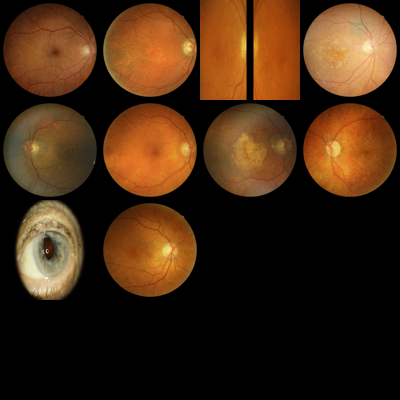

Number of Topcon images: 10


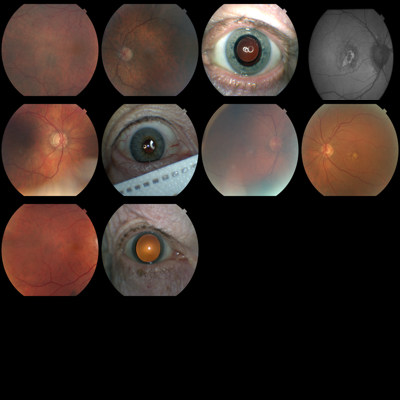

Number of Eidon images: 10


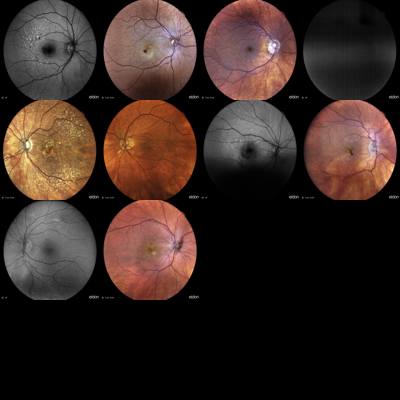

Number of Slit Lamp images: 10


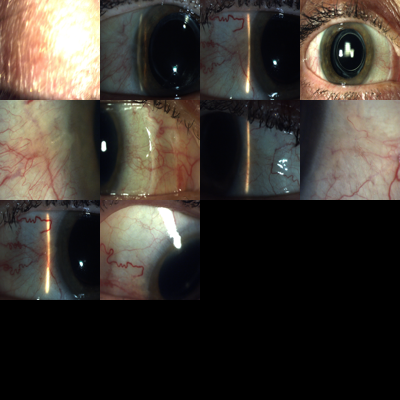

Number of Optos images: 10


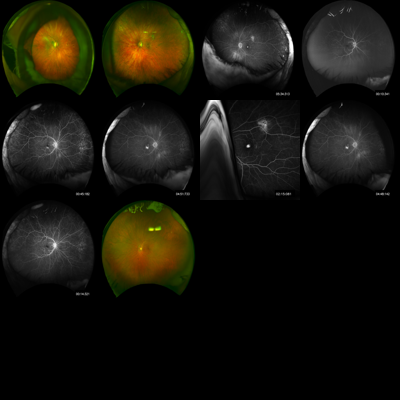

Number of Ellex images: 10


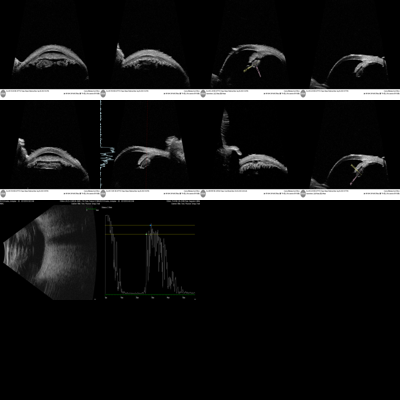

Number of Spectralis OCT images: 100


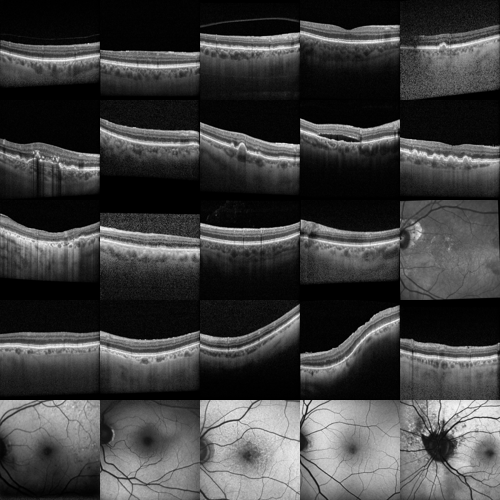

In [87]:
for device in devices:
    df_subset = df[df.devname == device]
    print(f'Number of {device} images: {len(df_subset)}')
    im = load_images(df_subset.file_path_coris.tolist())
    display(im)

## Visualize by annotated modality

In [ ]:
# load raw dataframe
raw_data = 'coris_db_subsets/image_modality_classifier/raw_data_oct_af_ir.csv'
df = pd.read_csv('../' + raw_data)

# remove non-existent paths
df = df[df.file_path_coris.apply(os.path.exists)]

# remove dicoms
df = df[df.file_path_coris.str.endswith('.j2k')]
df

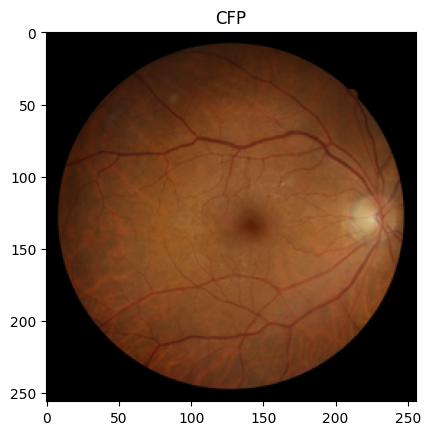

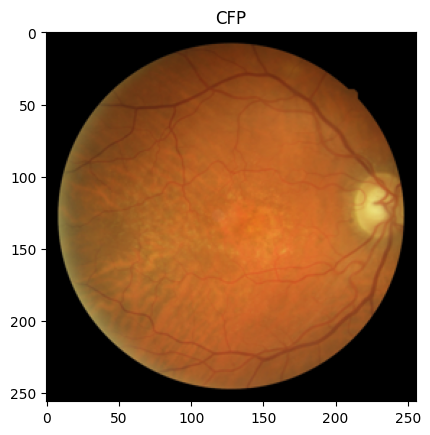

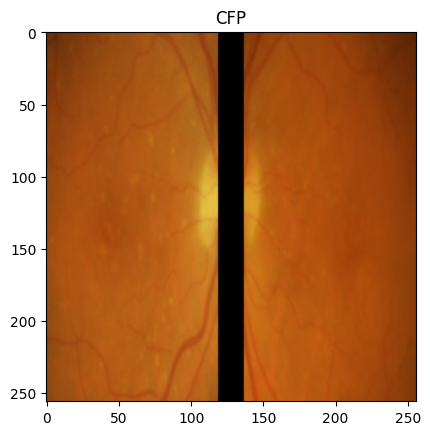

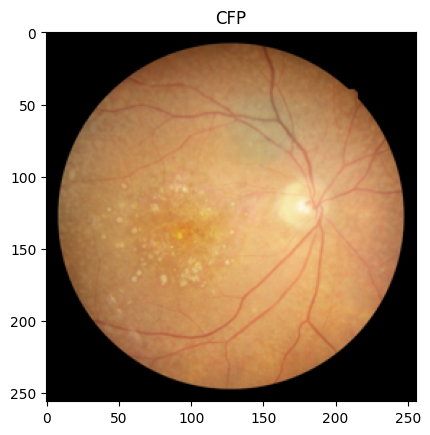

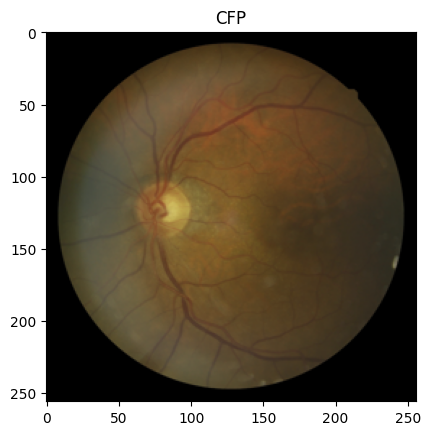

...

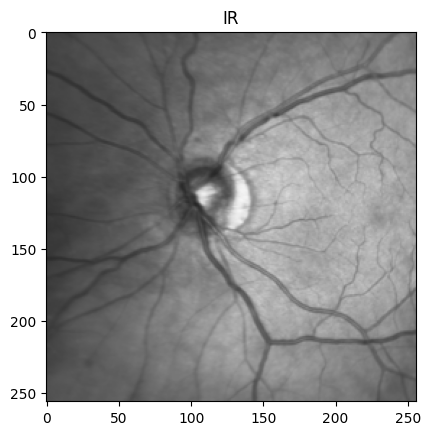

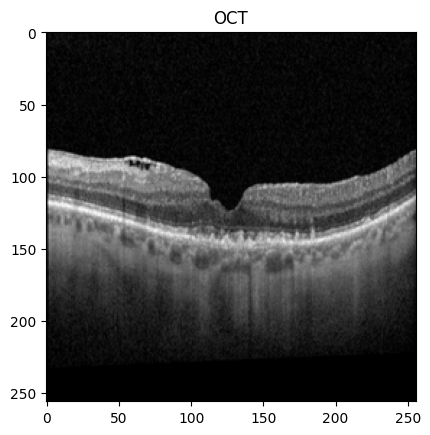

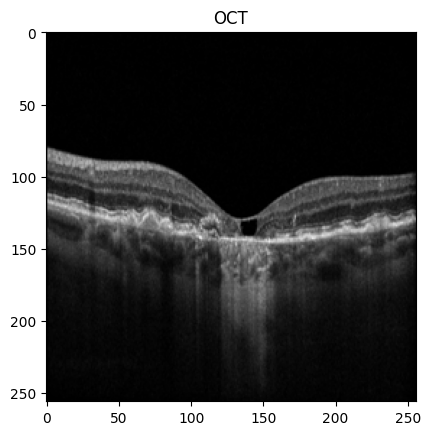

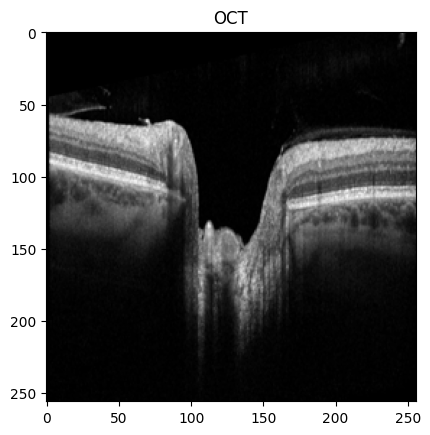

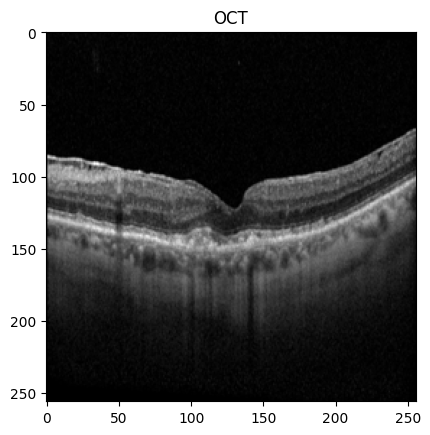

In [90]:
for i, row in df.iterrows():
    im = Image.open(row.file_path_coris).resize((256, 256))
    plt.figure()
    plt.imshow(im)
    plt.title(row.modality)
    plt.show()
    plt.close()